## Import Libraries

In [21]:
import sys
import os
from pathlib import Path
from typing import Tuple

import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import ollama
import json
from tqdm import tqdm
import time
import numpy as np

%matplotlib inline
sns.set_theme()

## Specify Paths

In [22]:
train_data_dir = "../data/train_data"
test_data_dir = "../data/test_data"
train_labels = "../data/train_labels.csv"

## Load Dataset

In [23]:
df = pd.read_csv(train_labels)
print(f"Total images in dataset: {len(df)}")
df.head()

Total images in dataset: 1412


,sample_index,label
0,img_0000.png,Triple negative
1,img_0001.png,Luminal A
2,img_0002.png,Luminal A
3,img_0003.png,Luminal B
4,img_0004.png,HER2(+)


## Green Contamination Filter

Simple and effective: detects bright green slime/goo overlay (Shrek artifacts, contamination)

In [24]:
def detect_green_contamination(image_path: str, mask_dir: str = None, mask: bool = False, green_threshold: float = 5.0) -> tuple:
    """
    Detect green/brown contamination (bright green goo, olive Shrek) within tissue mask.
    
    Args:
        image_path: Path to the image file
        mask_dir: Directory containing mask images (mask_{num}.png)
        mask: Whether to use tissue mask for analysis (default: False = analyze entire image)
        green_threshold: Percentage threshold for flagging as outlier (default: 5%)
    
    Returns:
        Tuple: (has_green_contamination: bool, green_percentage: float)
    """
    try:
        # Read image
        img = cv2.imread(image_path)
        if img is None:
            return False, 0.0
        
        # Initialize tissue_mask based on mask parameter
        tissue_mask = None
        
        if mask:
            # Try to load corresponding mask
            if mask_dir is not None:
                # Extract the number from image filename (e.g., "20001.png" -> "20001")
                img_name = os.path.basename(image_path)
                img_num = os.path.splitext(img_name)[0]
                mask_path = os.path.join(mask_dir, f"mask_{img_num}.png")
                
                if os.path.exists(mask_path):
                    mask_img = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
                    if mask_img is not None:
                        # Convert mask to binary (any non-zero value = foreground)
                        tissue_mask = mask_img > 0
            
            # If mask requested but not found, use color-based mask
            if tissue_mask is None:
                img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV).astype(np.float32)
                h_channel = img_hsv[:, :, 0]
                
                # Create tissue mask: pink/purple/blue colors (medical tissue)
                # Red/Magenta range: 0-30 or 140-180 in OpenCV HSV
                tissue_mask = (
                    ((h_channel >= 0) & (h_channel <= 30)) |     # Red/Magenta
                    ((h_channel >= 140) & (h_channel <= 180))     # Purple/Blue
                )
        else:
            # If mask=False, analyze entire image (all pixels)
            tissue_mask = np.ones((img.shape[0], img.shape[1]), dtype=bool)
        
        # Convert to HSV for color analysis
        img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV).astype(np.float32)
        h_channel = img_hsv[:, :, 0]
        s_channel = img_hsv[:, :, 1]
        v_channel = img_hsv[:, :, 2]
        
        # Detect EXACT neon green (the goo you showed - pure RGB green)
        # OpenCV Hue for pure green: ~60 degrees (range 55-65 in 0-180 scale)
        pure_neon_mask = (
            ((h_channel > 50) & (h_channel < 70)) &  # Pure green hue
            (s_channel > 200) &                        # Maximum saturation
            (v_channel > 200)                          # Maximum brightness
        )
        
        # Detect medium green (green slime/goo - slightly less saturated)
        medium_green_mask = (
            ((h_channel > 45) & (h_channel < 75)) &  # Medium green hue range
            (s_channel > 150) &                        # High saturation
            (v_channel > 180)                          # High brightness
        )
        
        # Detect Shrek/olive color (brownish-green, darker)
        # Hue around 35-50 (olive/brown-green), medium-high saturation
        shrek_mask = (
            ((h_channel > 30) & (h_channel < 50)) &  # Olive/brown-green hue range
            (s_channel > 80) &                         # Good saturation
            (v_channel > 100)                          # Medium to high brightness
        )
        
        # Combine all contamination detections
        contamination_mask = np.logical_or(
            np.logical_or(pure_neon_mask, medium_green_mask),
            shrek_mask
        )
        
        # Calculate contamination percentage within the analysis region (mask or entire image)
        contamination_in_tissue = np.logical_and(contamination_mask, tissue_mask)
        tissue_pixels = np.sum(tissue_mask)
        
        if tissue_pixels == 0:
            # No tissue detected, can't evaluate
            return False, 0.0
        
        green_percentage = np.sum(contamination_in_tissue) / tissue_pixels * 100
        is_contaminated = green_percentage > green_threshold
        
        return is_contaminated, green_percentage
        
    except Exception as e:
        return False, 0.0


In [25]:
def detect_green_simple(image_path: str, mask_dir: str = None, mask: bool = False) -> tuple:
    """
    Simple contamination detector for green and orangy-yellow (Shrek) colors.

    Args:
        image_path: Path to the image file
        mask_dir: Directory containing mask images (mask_{num}.png)
        mask: Whether to use tissue mask for analysis (default: False = analyze entire image)

    Returns:
        Tuple: (has_contamination: bool, contamination_pixel_count: int)
    """
    # --- CONFIGURATION ---
    # Broad Green Range (Covers Shrek & Splashes)
    LOWER_GREEN = np.array([35, 50, 50])
    UPPER_GREEN = np.array([85, 255, 255])
    # Orangy Shrek Range (yellow/orange)
    LOWER_ORANGE = np.array([10, 80, 80])
    UPPER_ORANGE = np.array([30, 255, 255])
    PIXEL_THRESHOLD = 500  # If >500 contamination pixels, it's junk
    # ---------------------

    try:
        img = cv2.imread(image_path)
        if img is None:
            return False, 0

        # Mask logic
        if mask:
            tissue_mask = None
            if mask_dir is not None:
                img_name = os.path.basename(image_path)
                img_num = os.path.splitext(img_name)[0]
                mask_path = os.path.join(mask_dir, f"mask_{img_num}.png")
                if os.path.exists(mask_path):
                    mask_img = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
                    if mask_img is not None:
                        tissue_mask = mask_img > 0
            if tissue_mask is None:
                img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV).astype(np.float32)
                h_channel = img_hsv[:, :, 0]
                tissue_mask = (
                    ((h_channel >= 0) & (h_channel <= 30)) |
                    ((h_channel >= 140) & (h_channel <= 180))
                )
        else:
            tissue_mask = np.ones((img.shape[0], img.shape[1]), dtype=bool)

        img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

        # Green mask
        green_mask = cv2.inRange(img_hsv, LOWER_GREEN, UPPER_GREEN)
        # Orangy-yellow mask
        orange_mask = cv2.inRange(img_hsv, LOWER_ORANGE, UPPER_ORANGE)

        # Combine both
        contamination_mask = np.logical_or(green_mask > 0, orange_mask > 0)
        contamination_in_tissue = np.logical_and(contamination_mask, tissue_mask)
        contamination_pixel_count = np.sum(contamination_in_tissue)
        is_contaminated = contamination_pixel_count > PIXEL_THRESHOLD

        return is_contaminated, contamination_pixel_count

    except Exception as e:
        return False, 0

## Process All Images with Ollama

**WARNING:** This will take a long time for large datasets! Start with a small sample first.

In [26]:
# Process all images - check for green contamination using masks
df_to_process = df # df.sample(200, random_state=42)

# Path to mask directory
mask_dir = train_data_dir  # Masks are in the same directory as images

results = []
for idx, row in tqdm(df_to_process.iterrows(), total=len(df_to_process), desc="Analyzing images"):
    image_path = os.path.join(train_data_dir, row['sample_index'])
    is_contaminated, green_pct = detect_green_simple(image_path)
    
    results.append({
        'sample_index': row['sample_index'],
        'label': row['label'],
        'is_outlier': is_contaminated,
        'green_percentage': green_pct
    })

# Create results dataframe
df_results = pd.DataFrame(results)
print(f"Processing complete!")
print(f"Green contamination detected: {df_results['is_outlier'].sum()}")
df_results

Analyzing images: 100%|██████████| 1412/1412 [00:26<00:00, 54.12it/s]

Processing complete!
Green contamination detected: 256


,sample_index,label,is_outlier,green_percentage
0,img_0000.png,Triple negative,False,0
1,img_0001.png,Luminal A,False,0
2,img_0002.png,Luminal A,False,0
3,img_0003.png,Luminal B,False,0
4,img_0004.png,HER2(+),False,0
...,...,...,...,...
1407,img_1407.png,Luminal B,False,0
1408,img_1408.png,Luminal B,False,0
1409,img_1409.png,Luminal A,False,15
1410,img_1410.png,Luminal A,False,0


## Analyze Outlier Detection Results

In [27]:
# Summary statistics
print("Green Contamination Filter Summary:")
print(f"Total images analyzed: {len(df_results)}")
print(f"Images with green contamination: {df_results['is_outlier'].sum()}")
print(f"Clean images: {(~df_results['is_outlier']).sum()}")
print(f"Contamination rate: {df_results['is_outlier'].sum() / len(df_results) * 100:.2f}%")

print("\nGreen contamination statistics:")
print(f"  Mean green %: {df_results['green_percentage'].mean():.2f}%")
print(f"  Max green %: {df_results['green_percentage'].max():.2f}%")
print(f"  Min green %: {df_results['green_percentage'].min():.2f}%")

# Show flagged outliers
df_flagged = df_results[df_results['is_outlier']]
print(f"\n{len(df_flagged)} images with green contamination:")
df_flagged[['sample_index', 'label', 'green_percentage']]

Green Contamination Filter Summary:
Total images analyzed: 1412
Images with green contamination: 256
Clean images: 1156
Contamination rate: 18.13%

Green contamination statistics:
  Mean green %: 20312.32%
  Max green %: 833759.00%
  Min green %: 0.00%

256 images with green contamination:


,sample_index,label,green_percentage
102,img_0102.png,Triple negative,55887
104,img_0104.png,Luminal A,406586
108,img_0108.png,Luminal A,71737
109,img_0109.png,HER2(+),90630
112,img_0112.png,Luminal A,72939
...,...,...,...
1381,img_1381.png,HER2(+),164345
1385,img_1385.png,HER2(+),113318
1388,img_1388.png,Triple negative,53489
1389,img_1389.png,HER2(+),48734


## Visualize Flagged Images

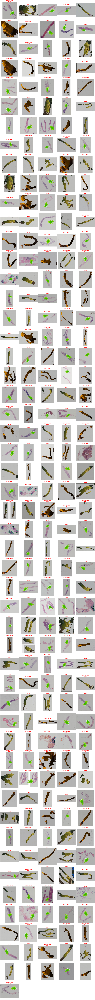

In [28]:
# Visualize detected green contamination
if len(df_flagged) > 0:
    n_to_show = len(df_flagged)
    n_cols = 5
    n_rows = (n_to_show + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 4*n_rows))
    if n_rows == 1:
        axes = axes.reshape(1, -1)
    
    for i, (idx, row) in enumerate(df_flagged.head(n_to_show).iterrows()):
        ax = axes[i // n_cols, i % n_cols]
        img_path = os.path.join(train_data_dir, row['sample_index'])
        img = cv2.imread(img_path)
        if img is not None:
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            ax.imshow(img_rgb)
            ax.set_title(f"GREEN CONTAMINATION\n{row['green_percentage']:.1f}%", fontsize=9, color='red', weight='bold')
        ax.axis('off')
    
    # Hide empty subplots
    for i in range(n_to_show, n_rows * n_cols):
        axes[i // n_cols, i % n_cols].axis('off')
    
    plt.tight_layout()
    plt.show()
else:
    print("No green contamination detected!")

## Create Cleaned Dataset

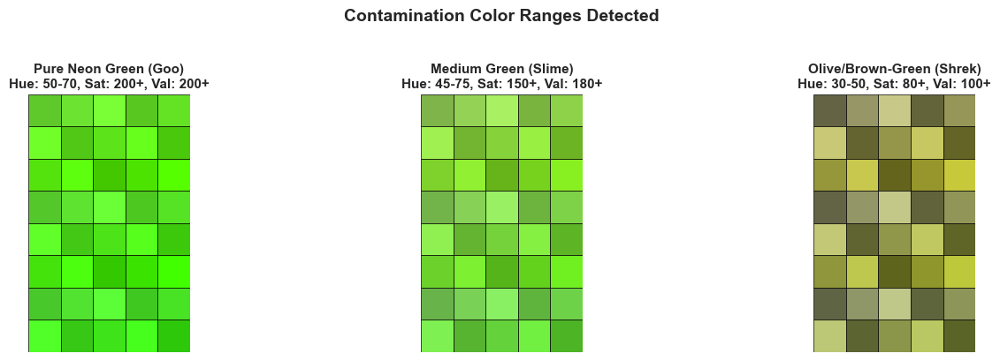

Color palette visualization:
- Left: Pure NEON green (RGB #00FF00 range, max saturation & brightness) - Exact goo color
- Middle: Medium green (saturated, bright) - Green slime variations
- Right: Olive/brown-green (less saturated, darker) - Shrek character


In [29]:
import matplotlib.patches as mpatches
from matplotlib.colors import hsv_to_rgb

# Create color palette visualization
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# Color 1: Pure Neon Green (Exact goo color - pure RGB green)
pure_neon_colors = []
for hue in np.linspace(50/180, 70/180, 10):
    for sat in np.linspace(200/255, 255/255, 5):
        for val in np.linspace(200/255, 255/255, 3):
            pure_neon_colors.append([hue, sat, val])

pure_neon_rgb = [hsv_to_rgb([c[0], c[1], c[2]]) for c in pure_neon_colors]

ax = axes[0]
for i, color in enumerate(pure_neon_rgb):
    row = i // 5
    col = i % 5
    rect = mpatches.Rectangle((col, row), 1, 1, facecolor=color, edgecolor='black', linewidth=0.5)
    ax.add_patch(rect)
ax.set_xlim(0, 5)
ax.set_ylim(0, 8)
ax.set_aspect('equal')
ax.invert_yaxis()
ax.set_title('Pure Neon Green (Goo)\nHue: 50-70, Sat: 200+, Val: 200+', fontsize=11, weight='bold')
ax.axis('off')

# Color 2: Medium Green (Slime)
medium_green_colors = []
for hue in np.linspace(45/180, 75/180, 10):
    for sat in np.linspace(150/255, 220/255, 5):
        for val in np.linspace(180/255, 240/255, 3):
            medium_green_colors.append([hue, sat, val])

medium_green_rgb = [hsv_to_rgb([c[0], c[1], c[2]]) for c in medium_green_colors]

ax = axes[1]
for i, color in enumerate(medium_green_rgb):
    row = i // 5
    col = i % 5
    rect = mpatches.Rectangle((col, row), 1, 1, facecolor=color, edgecolor='black', linewidth=0.5)
    ax.add_patch(rect)
ax.set_xlim(0, 5)
ax.set_ylim(0, 8)
ax.set_aspect('equal')
ax.invert_yaxis()
ax.set_title('Medium Green (Slime)\nHue: 45-75, Sat: 150+, Val: 180+', fontsize=11, weight='bold')
ax.axis('off')

# Color 3: Olive/Brown-Green (Shrek)
shrek_colors = []
for hue in np.linspace(30/180, 50/180, 10):
    for sat in np.linspace(80/255, 180/255, 5):
        for val in np.linspace(100/255, 200/255, 3):
            shrek_colors.append([hue, sat, val])

shrek_rgb = [hsv_to_rgb([c[0], c[1], c[2]]) for c in shrek_colors]

ax = axes[2]
for i, color in enumerate(shrek_rgb):
    row = i // 5
    col = i % 5
    rect = mpatches.Rectangle((col, row), 1, 1, facecolor=color, edgecolor='black', linewidth=0.5)
    ax.add_patch(rect)
ax.set_xlim(0, 5)
ax.set_ylim(0, 8)
ax.set_aspect('equal')
ax.invert_yaxis()
ax.set_title('Olive/Brown-Green (Shrek)\nHue: 30-50, Sat: 80+, Val: 100+', fontsize=11, weight='bold')
ax.axis('off')

plt.suptitle('Contamination Color Ranges Detected', fontsize=14, weight='bold', y=1.02)
plt.tight_layout()
plt.show()

print("Color palette visualization:")
print("- Left: Pure NEON green (RGB #00FF00 range, max saturation & brightness) - Exact goo color")
print("- Middle: Medium green (saturated, bright) - Green slime variations")
print("- Right: Olive/brown-green (less saturated, darker) - Shrek character")

## Color Palette Visualization

Visual guide to the detected contamination colors

In [30]:
# Create cleaned dataset (remove detected outliers)
df_cleaned = df_to_process.merge(df_results[['sample_index', 'is_outlier']], 
                                   on='sample_index', how='left')

# Keep only non-outlier images
df_cleaned = df_cleaned[df_cleaned['is_outlier'] == False]
df_cleaned = df_cleaned.drop('is_outlier', axis=1)

print(f"Original dataset size: {len(df_to_process)}")
print(f"Cleaned dataset size: {len(df_cleaned)}")
print(f"Removed {len(df_to_process) - len(df_cleaned)} outliers ({(len(df_to_process) - len(df_cleaned)) / len(df_to_process) * 100:.1f}%)")

df_cleaned.head()

Original dataset size: 1412
Cleaned dataset size: 1156
Removed 256 outliers (18.1%)


,sample_index,label
0,img_0000.png,Triple negative
1,img_0001.png,Luminal A
2,img_0002.png,Luminal A
3,img_0003.png,Luminal B
4,img_0004.png,HER2(+)


## Save Cleaned Dataset (Optional)

In [33]:
# Uncomment to save the cleaned dataset
df_cleaned.to_csv("../data/train_labels_cleaned.csv", index=False)
print("Cleaned dataset saved to ../data/train_labels_cleaned.csv")

Cleaned dataset saved to ../data/train_labels_cleaned.csv


## Save Outlier Analysis Results (Optional)

In [32]:
# Uncomment to save the full analysis results
df_results.to_csv("../data/outlier_analysis_results.csv", index=False)
print("Outlier analysis results saved to ../data/outlier_analysis_results.csv")

Outlier analysis results saved to ../data/outlier_analysis_results.csv
